<https://betterdatascience.com/data-science-for-cycling-how-to-read-gpx-strava-routes-with-python/>

In [ ]:
!pip install gpxpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 111 kB 5.0 MB/s 
  Created wheel for gpxpy: filename=gpxpy-1.5.0-py3-none-any.whl size=42899 sha256=a4a694e513679bf15a1a1cd424f876bb96b953d723146779b1badbd8041199c5
  Stored in directory: /root/.cache/pip/wheels/93/15/ce/1cd2782b440b8a517b89c3fa112f79f7015bd6e51b552e1b1a
Successfully built gpxpy


In [ ]:
import gpxpy
import gpxpy.gpx

import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False

In [ ]:
from google.colab import files
uploaded = files.upload()
import io


Saving PL-SK-HU.gpx to PL-SK-HU.gpx


In [ ]:
with open('PL-SK-HU.gpx', 'r') as gpx_file:
    gpx = gpxpy.parse(gpx_file)

In [ ]:
gpx.get_track_points_no()

31645

In [ ]:
gpx.get_elevation_extremes()

MinimumMaximum(minimum=130.615291, maximum=966.654872)

In [ ]:
gpx.get_uphill_downhill()

UphillDownhill(uphill=4415.3356269999995, downhill=4639.101706000003)

In [ ]:
route_info = []

for track in gpx.tracks:
    for segment in track.segments:
        for point in segment.points:
            route_info.append({
                'latitude': point.latitude,
                'longitude': point.longitude,
                'elevation': point.elevation
            })

In [ ]:
route_df = pd.DataFrame(route_info)
route_df.head()

,latitude,longitude,elevation
0,49.864104,19.109029,386.362446
1,49.864275,19.109137,386.362446
2,49.864374,19.109211,386.362446
3,49.864470,19.109280,386.362446
4,49.864582,19.109354,386.362446


## Plots

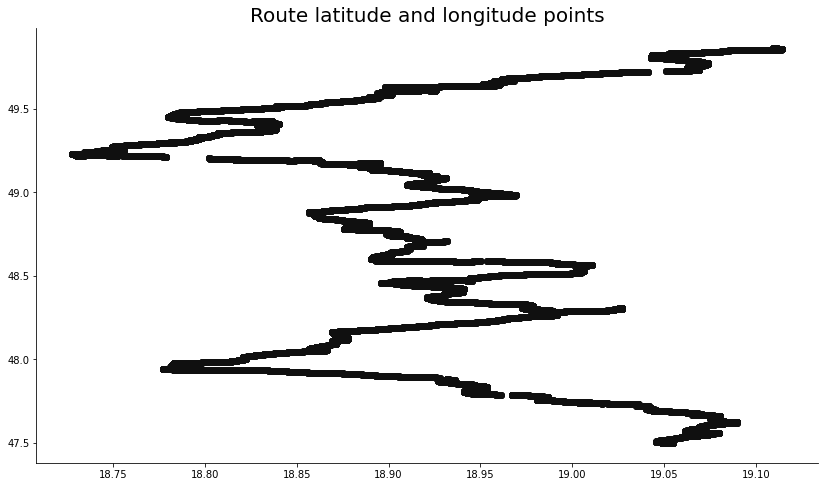

In [ ]:
plt.figure(figsize=(14, 8))
plt.scatter(route_df['longitude'], route_df['latitude'], color='#101010')
plt.title('Route latitude and longitude points', size=20);

In [ ]:
#route_df.to_csv('../data/route_df.csv', index=False)


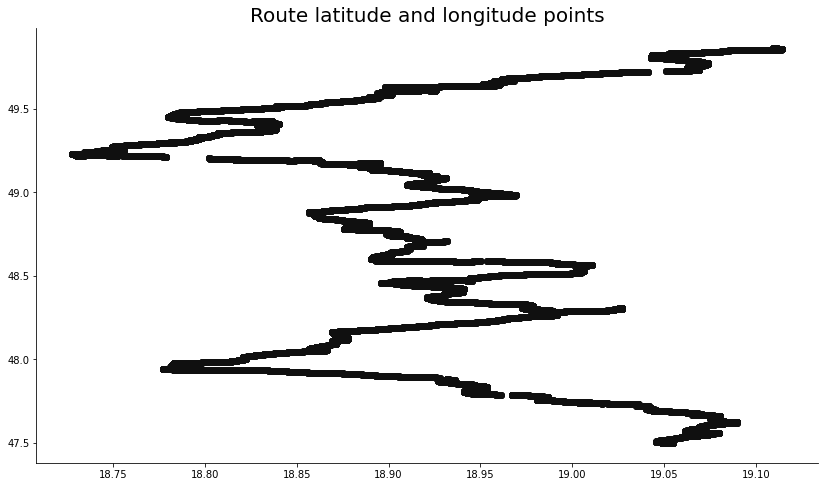

In [ ]:
plt.figure(figsize=(14, 8))
plt.scatter(route_df['longitude'], route_df['latitude'], color='#101010')
plt.title('Route latitude and longitude points', size=20);

## Maps - Folium

Folium is a Python library used to visualize geospatial data. It’s just a wrapper for Leaflet, an open-source JavaScript library for plotting interactive maps.

In [ ]:
!pip install folium


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import folium

In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=6,
    tiles='OpenStreetMap',
    width=1024,
    height=600
)
display(route_map)

### One Route Display

In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=6,
    tiles='OpenStreetMap',
    width=1024,
    height=600
)

for _, row in route_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
    ).add_to(route_map)

display(route_map)

In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=6,
    tiles='OpenStreetMap',
    width=1024,
    height=600
)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=6,
    tiles='CartoDBPositron',
    width=1024,
    height=600
)


coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=6,
    tiles='CartoDBDark_Matter',
    width=1024,
    height=600
)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

### Multiple Routes Display

In [ ]:
from google.colab import files
uploaded = files.upload()
import io


Saving EE-LT.gpx to EE-LT.gpx


In [ ]:
with open('EE-LT.gpx', 'r') as gpx_file:
    gpx_2 = gpxpy.parse(gpx_file)


route_info_2 = []

for track in gpx_2.tracks:
    for segment in track.segments:
        for point in segment.points:
            route_info_2.append({
                'latitude': point.latitude,
                'longitude': point.longitude,
                'elevation': point.elevation
            })   


route_df_2 = pd.DataFrame(route_info_2)
route_df_2.head()             

,latitude,longitude,elevation
0,59.477593,24.835684,19.729997
1,59.477486,24.835547,19.729997
2,59.477076,24.835328,19.729997
3,59.476795,24.835209,19.729997
4,59.476598,24.835342,19.731104


In [ ]:
with open('HU-GR.gpx', 'r') as gpx_file:
    gpx_3 = gpxpy.parse(gpx_file)


route_info_3 = []

for track in gpx_3.tracks:
    for segment in track.segments:
        for point in segment.points:
            route_info_3.append({
                'latitude': point.latitude,
                'longitude': point.longitude,
                'elevation': point.elevation
            })   


route_df_3 = pd.DataFrame(route_info_3)
route_df_3.head()             

,latitude,longitude,elevation
0,47.634836,19.079729,101.675182
1,47.634213,19.080162,101.675182
2,47.632601,19.082329,101.428709
3,47.632461,19.082461,101.455441
4,47.632335,19.082412,101.476433


In [ ]:
route_map = folium.Map(
    location=[48.4, 19.3],
    zoom_start=3,
    tiles='OpenStreetMap',
    width=800,
    height=600
)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=3, color='#83db5a').add_to(route_map)

coordinates_2 = [tuple(x) for x in route_df_2[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates_2, weight=3).add_to(route_map)

coordinates_3 = [tuple(x) for x in route_df_3[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates_3, weight=3,color='#7d7b77').add_to(route_map)



display(route_map)

## Distance and Elevation profile

In [ ]:
!pip install haversine

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import haversine as hs

def haversine_distance(lat1, lon1, lat2, lon2) -> float:
    distance = hs.haversine(
        point1=(lat1, lon1),
        point2=(lat2, lon2),
        unit=hs.Unit.METERS
    )
    return np.round(distance, 2)

In [ ]:
haversine_distance(
    lat1=route_df.iloc[0]['latitude'],
    lon1=route_df.iloc[0]['longitude'],
    lat2=route_df.iloc[1]['latitude'],
    lon2=route_df.iloc[1]['longitude']
)

20.53

In [ ]:
import numpy as np

distances = [np.nan]

for i in range(len(route_df)):
    if i == 0:
        continue
    else:
        distances.append(haversine_distance(
            lat1=route_df.iloc[i - 1]['latitude'],
            lon1=route_df.iloc[i - 1]['longitude'],
            lat2=route_df.iloc[i]['latitude'],
            lon2=route_df.iloc[i]['longitude']
        ))
        
route_df['distance'] = distances
route_df.head()

,latitude,longitude,elevation,distance
0,49.864104,19.109029,386.362446,NaN
1,49.864275,19.109137,386.362446,20.53
2,49.864374,19.109211,386.362446,12.22
3,49.864470,19.109280,386.362446,11.76
4,49.864582,19.109354,386.362446,13.54


In [ ]:
route_df['distance'].sum()


403980.26

In [ ]:
route_df['elevation_diff'] = route_df['elevation'].diff()

route_df.head()

,latitude,longitude,elevation,distance,elevation_diff
0,49.864104,19.109029,386.362446,NaN,NaN
1,49.864275,19.109137,386.362446,20.53,0.0
2,49.864374,19.109211,386.362446,12.22,0.0
3,49.864470,19.109280,386.362446,11.76,0.0
4,49.864582,19.109354,386.362446,13.54,0.0


In [ ]:
route_df['cum_elevation'] = route_df['elevation_diff'].cumsum()
route_df['cum_distance'] = route_df['distance'].cumsum()

route_df.head()

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance
0,49.864104,19.109029,386.362446,NaN,NaN,NaN,NaN
1,49.864275,19.109137,386.362446,20.53,0.0,0.0,20.53
2,49.864374,19.109211,386.362446,12.22,0.0,0.0,32.75
3,49.864470,19.109280,386.362446,11.76,0.0,0.0,44.51
4,49.864582,19.109354,386.362446,13.54,0.0,0.0,58.05


In [ ]:
route_df = route_df.fillna(0)

route_df.head()

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance
0,49.864104,19.109029,386.362446,0.00,0.0,0.0,0.00
1,49.864275,19.109137,386.362446,20.53,0.0,0.0,20.53
2,49.864374,19.109211,386.362446,12.22,0.0,0.0,32.75
3,49.864470,19.109280,386.362446,11.76,0.0,0.0,44.51
4,49.864582,19.109354,386.362446,13.54,0.0,0.0,58.05


In [ ]:
#route_df.to_csv('../data/route_df_elevation_distance.csv', index=False)


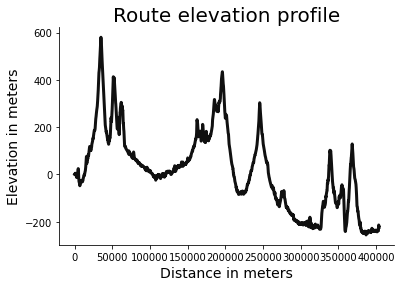

In [ ]:
plt.plot(route_df['cum_distance'], route_df['cum_elevation'], color='#101010', lw=3)
plt.title('Route elevation profile', size=20)
plt.xlabel('Distance in meters', size=14)
plt.ylabel('Elevation in meters', size=14);
plt.savefig('fig.jpg', dpi=300, bbox_inches='tight')

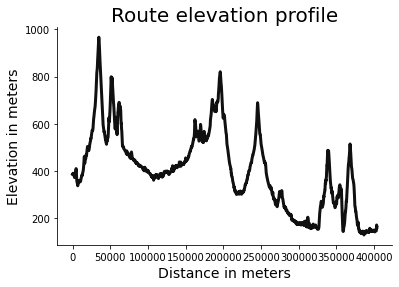

In [ ]:
route_df['cum_elevation'] = route_df['cum_elevation'] + 386

plt.plot(route_df['cum_distance'], route_df['cum_elevation'], color='#101010', lw=3)
plt.title('Route elevation profile', size=20)
plt.xlabel('Distance in meters', size=14)
plt.ylabel('Elevation in meters', size=14);
plt.savefig('fig.jpg', dpi=300, bbox_inches='tight')

In [ ]:
max(route_df['cum_elevation'])

966.292426

In [ ]:
gradients = [np.nan]

for ind, row in route_df.iterrows(): 
    if ind == 0:
        continue
    grade = (row['elevation_diff'] / row['distance']) * 100
    gradients.append(np.round(grade, 1))
    
gradients[:10]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in double_scalars
  


[nan, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.6, -0.6]

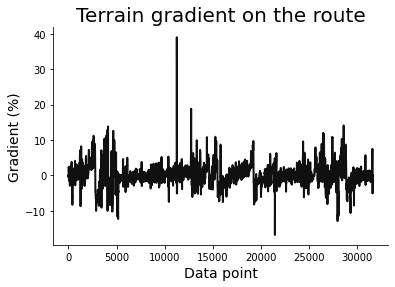

In [ ]:
plt.title('Terrain gradient on the route', size=20)
plt.xlabel('Data point', size=14)
plt.ylabel('Gradient (%)', size=14)
plt.plot(np.arange(len(gradients)), gradients, lw=2, color='#101010');

In [ ]:
gradients = [np.nan]

for ind, row in route_df.iterrows(): 
    if ind == 0:
        continue
        
    grade = (row['elevation_diff'] / row['distance']) * 100
    
    if grade > 30:
        gradients.append(np.nan)
    else:
        gradients.append(np.round(grade, 1))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in double_scalars
  import sys


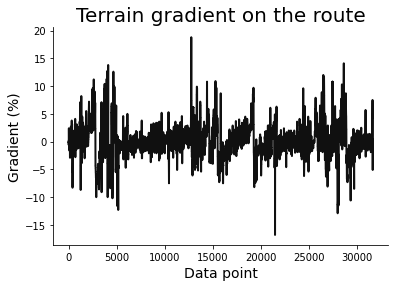

In [ ]:
plt.title('Terrain gradient on the route', size=20)
plt.xlabel('Data point', size=14)
plt.ylabel('Gradient (%)', size=14)
plt.plot(np.arange(len(gradients)), gradients, lw=2, color='#101010');

In [ ]:
route_df['gradient'] = gradients
route_df.head()

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient
0,49.864104,19.109029,386.362446,0.00,0.0,386.0,0.00,NaN
1,49.864275,19.109137,386.362446,20.53,0.0,386.0,20.53,0.0
2,49.864374,19.109211,386.362446,12.22,0.0,386.0,32.75,0.0
3,49.864470,19.109280,386.362446,11.76,0.0,386.0,44.51,0.0
4,49.864582,19.109354,386.362446,13.54,0.0,386.0,58.05,0.0


In [ ]:
route_df[route_df['gradient'].isna()]

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient
0,49.864104,19.109029,386.362446,0.00,0.000000,386.000000,0.00,NaN
11270,49.114779,18.921447,438.795816,46.81,18.255517,438.433370,143567.63,NaN
26912,47.881616,18.931949,326.414275,0.00,0.000000,326.051829,343223.86,NaN


In [ ]:
route_df[401:406]

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient
401,49.837525,19.074329,396.067984,11.77,-0.801512,395.705538,5105.66,-6.8
402,49.837450,19.074221,395.128621,11.38,-0.939363,394.766175,5117.04,-8.3
403,49.837376,19.074113,394.195962,11.30,-0.932659,393.833516,5128.34,-8.3
404,49.837305,19.074000,393.262189,11.31,-0.933773,392.899743,5139.65,-8.3
405,49.837242,19.073874,392.318527,11.43,-0.943662,391.956081,5151.08,-8.3


In [ ]:
route_df[401:406].interpolate()


,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient
401,49.837525,19.074329,396.067984,11.77,-0.801512,395.705538,5105.66,-6.8
402,49.837450,19.074221,395.128621,11.38,-0.939363,394.766175,5117.04,-8.3
403,49.837376,19.074113,394.195962,11.30,-0.932659,393.833516,5128.34,-8.3
404,49.837305,19.074000,393.262189,11.31,-0.933773,392.899743,5139.65,-8.3
405,49.837242,19.073874,392.318527,11.43,-0.943662,391.956081,5151.08,-8.3


In [ ]:
route_df['gradient'] = route_df['gradient'].interpolate().fillna(0)

route_df.head()

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient
0,49.864104,19.109029,386.362446,0.00,0.0,386.0,0.00,0.0
1,49.864275,19.109137,386.362446,20.53,0.0,386.0,20.53,0.0
2,49.864374,19.109211,386.362446,12.22,0.0,386.0,32.75,0.0
3,49.864470,19.109280,386.362446,11.76,0.0,386.0,44.51,0.0
4,49.864582,19.109354,386.362446,13.54,0.0,386.0,58.05,0.0


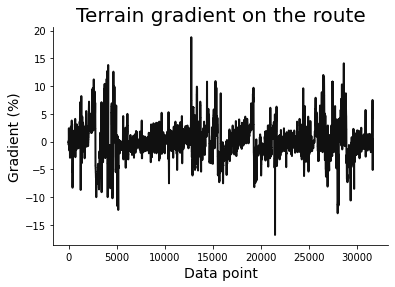

In [ ]:
plt.title('Terrain gradient on the route', size=20)
plt.xlabel('Data point', size=14)
plt.ylabel('Gradient (%)', size=14)
plt.plot(np.arange(len(route_df)), route_df['gradient'], lw=2, color='#101010');

In [ ]:
#route_df.to_csv('../data/route_df_gradient.csv', index=False)


In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.offline as pyo

In [ ]:
route_df['gradient'].describe()


count    31645.000000
mean         0.094328
std          3.258285
min        -16.800000
25%         -1.500000
50%          0.000000
75%          1.600000
max         18.800000
Name: gradient, dtype: float64

In [ ]:
bins = pd.IntervalIndex.from_tuples([
    (-30, -10),
    (-10, -5), 
    (-5, -3), 
    (-3, -1), 
    (-1, 0),
    (0, 1), 
    (1, 3), 
    (3, 5), 
    (5, 7), 
    (7, 10), 
    (10, 12), 
    (12, 15), 
    (15, 20)
], closed='left')
bins

IntervalIndex([[-30, -10), [-10, -5), [-5, -3), [-3, -1), [-1, 0) ... [5, 7), [7, 10), [10, 12), [12, 15), [15, 20)], dtype='interval[int64, left]')

In [ ]:
route_df['gradient_range'] = pd.cut(route_df['gradient'], bins=bins)
route_df.head()

,latitude,longitude,elevation,distance,elevation_diff,cum_elevation,cum_distance,gradient,gradient_range
0,49.864104,19.109029,386.362446,0.00,0.0,386.0,0.00,0.0,"[0, 1)"
1,49.864275,19.109137,386.362446,20.53,0.0,386.0,20.53,0.0,"[0, 1)"
2,49.864374,19.109211,386.362446,12.22,0.0,386.0,32.75,0.0,"[0, 1)"
3,49.864470,19.109280,386.362446,11.76,0.0,386.0,44.51,0.0,"[0, 1)"
4,49.864582,19.109354,386.362446,13.54,0.0,386.0,58.05,0.0,"[0, 1)"


In [ ]:
gradient_details = []

# For each unique gradient range
for gr_range in route_df['gradient_range'].unique():
    # Keep that subset only
    subset = route_df[route_df['gradient_range'] == gr_range]
    
    # Statistics
    total_distance = subset['distance'].sum()
    pct_of_total_ride = (subset['distance'].sum() / route_df['distance'].sum()) * 100
    elevation_gain = subset[subset['elevation_diff'] > 0]['elevation_diff'].sum()
    elevation_lost = subset[subset['elevation_diff'] < 0]['elevation_diff'].sum()
    
    # Save results
    gradient_details.append({
        'gradient_range': gr_range,
        'total_distance': np.round(total_distance, 2),
        'pct_of_total_ride': np.round(pct_of_total_ride, 2),
        'elevation_gain': np.round(elevation_gain, 2),
        'elevation_lost': np.round(np.abs(elevation_lost), 2)
    })

In [ ]:
gradient_details_df = pd.DataFrame(gradient_details).sort_values(by='gradient_range').reset_index(drop=True)
gradient_details_df

,gradient_range,total_distance,pct_of_total_ride,elevation_gain,elevation_lost
0,"[-30, -10)",2103.25,0.52,0.00,238.19
1,"[-10, -5)",20813.93,5.15,0.00,1387.36
2,"[-5, -3)",26978.49,6.68,0.00,1060.81
3,"[-3, -1)",86472.81,21.41,0.00,1619.19
4,"[-1, 0)",70496.07,17.45,0.00,366.31
5,"[0, 1)",69964.27,17.32,297.21,0.75
6,"[1, 3)",79223.51,19.61,1424.35,0.00
7,"[3, 5)",23976.69,5.94,913.26,0.00
8,"[5, 7)",11138.75,2.76,640.92,0.00
9,"[7, 10)",9855.27,2.44,816.83,0.00


In [ ]:
colors = [
    '#0d46a0', '#2f3e9e', '#2195f2', '#4fc2f7',
    '#a5d6a7', '#66bb6a', '#fff59d', '#ffee58',
    '#ffca28', '#ffa000', '#ff6f00', '#f4511e', '#bf360c'
]

In [ ]:
custom_text = [f'''{gr}% - {dst}km''' for gr, dst in zip(
    gradient_details_df['gradient_range'].astype('str'),
    gradient_details_df['total_distance'].apply(lambda x: round(x / 1000, 2))
)]

In [ ]:
fig = go.Figure(
    data=[go.Bar(
        x=gradient_details_df['gradient_range'].astype(str),
        y=gradient_details_df['total_distance'].apply(lambda x: round(x / 1000, 2)),
        marker_color=colors,
        text=custom_text
    )],
    layout=go.Layout(
        bargap=0,
        title='Gradient profile of a route',
        xaxis_title='Gradient range (%)',
        yaxis_title='Distance covered (km)',
        autosize=False,
        width=1440,
        height=800,
        template='simple_white'
    )
)
fig.show()

## Dash

In [ ]:
!pip install dash

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 9.9 MB 3.7 MB/s 


In [ ]:
!pip install jupyter-dash

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.6 MB 7.7 MB/s 


In [ ]:
# Run this app with `python app.py` and
# visit http://127.0.0.1:8050/ in your web browser.

from dash import Dash, html, dcc
import plotly.express as px
import pandas as pd

app = Dash(__name__)

# assume you have a "long-form" data frame
# see https://plotly.com/python/px-arguments/ for more options
df = pd.DataFrame({
    "Fruit": ["Apples", "Oranges", "Bananas", "Apples", "Oranges", "Bananas"],
    "Amount": [4, 1, 2, 2, 4, 5],
    "City": ["SF", "SF", "SF", "Montreal", "Montreal", "Montreal"]
})

fig = px.bar(df, x="Fruit", y="Amount", color="City", barmode="group")

app.layout = html.Div(children=[
    html.H1(children='Hello Dash'),

    html.Div(children='''
        Dash: A web application framework for your data.
    '''),

    dcc.Graph(
        id='example-graph',
        figure=fig
    )
])

if __name__ == '__main__':
    #app.run_server(debug=True)
    app.run_server(mode='inline')

TypeError: ignored

In [ ]:
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
# Load Data
df = px.data.tips()
# Build App
app = JupyterDash(__name__)
app.layout = html.Div([
    html.H1("JupyterDash Demo"),
    dcc.Graph(id='graph'),
    html.Label([
        "colorscale",
        dcc.Dropdown(
            id='colorscale-dropdown', clearable=False,
            value='plasma', options=[
                {'label': c, 'value': c}
                for c in px.colors.named_colorscales()
            ])
    ]),
])
# Define callback to update graph
@app.callback(
    Output('graph', 'figure'),
    [Input("colorscale-dropdown", "value")]
)
def update_figure(colorscale):
    return px.scatter(
        df, x="total_bill", y="tip", color="size",
        color_continuous_scale=colorscale,
        render_mode="webgl", title="Tips"
    )
# Run app and display result inline in the notebook
app.run_server(mode='inline')

ModuleNotFoundError: ignored

## To try

In [ ]:
https://www.youtube.com/watch?v=JoQhEKh7u0c